# JamUNet model trained with the spatial dataset - testing and visualisation

This notebook was used for testing the model, computing the metric scores, and visualising the predictions.

In [167]:
%cd /workspace/jamunet-morpho-braided-main

/workspace/jamunet-morpho-braided-main


In [116]:
# reload modules to avoid restarting the notebook every time these are updated

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [117]:
# import modules 

import torch 
import copy
import time

from torch.utils.data import DataLoader

from model.train_eval import * 
from preprocessing.dataset_generation import create_full_dataset, create_full_dataset_averages #was originally create_full_dataset

from postprocessing.metrics import *
from postprocessing.plot_results import *
from postprocessing.save_results import load_model

# Enable interactive widgets in Jupyter Notebook
%matplotlib inline
%matplotlib widget

In [118]:
# set the device where operations are performed
# if only one GPU is present you might need to remove the index "0" 
# torch.device('cuda:0') --> torch.device('cuda') / torch.cuda.get_device_name(0) --> torch.cuda.get_device_name() 

if torch.cuda.is_available():
    device = torch.device('cuda:0')
    print("CUDA Device Count: ", torch.cuda.device_count())
    print("CUDA Device Name: ", torch.cuda.get_device_name(0))
else:
    device = 'cpu'
    
print(f'Using device: {device}')

CUDA Device Count:  1
CUDA Device Name:  NVIDIA A40
Using device: cuda:0


In [119]:
## Set seeds to 0 for reproducibility

np.random.seed(0)
torch.manual_seed(0)
torch.cuda.manual_seed(0)

In [120]:
# set common keys required for functions

train = 'training'
val = 'validation'
test = 'testing'

In [122]:
# load all datasets

# by default March images are used - if another month is used change the number (available months: 1-4)
# dataset_path = r'data/satellite/averages' 
dataset_path = r'data/satellite/dataset_month3'

dtype=torch.float32

val_set = create_full_dataset(val, dir_folders=dataset_path, device=device, dtype=dtype)
test_set = create_full_dataset(test, dir_folders=dataset_path, device=device, dtype=dtype)

In [129]:
print('Validation dataset samples: {len(val_set)},\n\
Testing dataset samples: {len(test_set)}')
# To check the shape of each tensor in the TensorDataset
for i, tensor in enumerate(val_set.tensors):
    print(f"Tensor {i} shape: {tensor.shape}")

Validation dataset samples: {len(val_set)},
Testing dataset samples: {len(test_set)}
Tensor 0 shape: torch.Size([19, 4, 1000, 500])
Tensor 1 shape: torch.Size([19, 1000, 500])


**<span style="color:red">Attention!</span> Always remember to load the correct <code>save_path</code> file before running the following cells, in order to match all keys successfully when loading the model.**

In [182]:
# load model with min val loss

save_path_loss = r'model/models_trained/UNet3D_Dice_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #1
# save_path_loss = r'model/models_trained/UNet3D_full_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #2
# save_path_loss = r'model/models_trained/UNet2D_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #3
# save_path_loss = r'model/models_trained/UNet_semi3D_Dice_drop_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #4
# save_path_loss = r'model/models_trained/UNet_semi3D_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #5
# save_path_loss = r'model/models_trained/UNet_semi3D_Dice_shallow8_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #6 
# save_path_loss = r'model/models_trained/UNet_semi3D_bloss_Dice_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #7
# save_path_loss = r'model/models_trained/UNet_semi3D_resBN_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #8
# save_path_loss = r'model/models_trained/UNet_semi3D_resBN_bloss_Dice_3_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #9
# save_path_loss = r'model/models_trained/UNet_semi3D_4_8_resBN_BCE_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #10
# save_path_loss = r'model/models_trained/UNet_semi3D_4_8_resBN_Dice_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #11
# save_path_loss = r'model/models_trained/12. UNet_semi3D_4_8_resBN_Dice_drop_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #12
# save_path_loss = r'model/models_trained/UNet_semi3D_resBN_3_8_Dice_bloss_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #13

In [183]:
# load model with max recall

save_path_recall = r'model/models_trained/UNet3D_Dice_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #1
# save_path_recall = r'model/models_trained/UNet3D_full_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #2
# save_path_recall = r'model/models_trained/UNet2D_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #3
# save_path_recall = r'model/models_trained/UNet_semi3D_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #4
# save_path_recall = r'model/models_trained/UNet_semi3D_Dice_drop_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #5
# save_path_recall = r'model/models_trained/UNet_semi3D_Dice_shallow8_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #6
# save_path_recall = r'model/models_trained/UNet_semi3D_brecall_Dice_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #7
# save_path_recall = r'model/models_trained/UNet_semi3D_resBN_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #8
# save_path_recall = r'model/models_trained/UNet_semi3D_resBN_brecall_Dice_3_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #9
# save_path_recall = r'model/models_trained/UNet_semi3D_4_8_resBN_BCE_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #10
# save_path_recall = r'model/models_trained/UNet_semi3D_4_8_resBN_Dice_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #11
# save_path_recall = r'model/models_trained/12. UNet_semi3D_4_8_resBN_Dice_drop_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth' #12
# save_path_recall = r'model/models_trained/UNet_semi3D_resBN_3_8_Dice_brecall_spatial_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.pth'

In [184]:
# load JamUNet architecture

from model.st_unet.st_unet import *

n_channels = test_set[0][0].shape[0]
n_classes = 1
init_hid_dim = 8
kernel_size = 3
pooling = 'max'

model_loss = UNet3D(n_channels=n_channels, n_classes=n_classes, init_hid_dim=init_hid_dim, kernel_size=kernel_size,          #1
               pooling=pooling, bilinear=False, drop_channels=False ,seed=42)

# model_loss = UNet3D_full(in_channels=1, out_channels=1, init_features=8, temporal=3, seed=42)                              #2
# model_loss = UNet2D(in_channels=4, out_channels=1, init_features=8, seed=42)                                                 #3 (BCE), #14 (Dice)
# model_loss = UNet_semi3D(in_channels=1, out_channels=1, init_features=8, seed=42)                                          #4 & #7
# model_loss = UNet_semi3D_drop(in_channels=1, out_channels=1, init_features=8, seed=42, dropout_rate=0.1)                   #5 BCE, #17 Dice  
# model_loss = UNet_semi3D_shallow8(in_channels=1, out_channels=1, init_features=8, seed=42)                                 #6, #15 BCE, #16 Dice
# model_loss = UNet_semi3D_4_8_resBN_Dice_drop(in_channels=1, out_channels=1, init_features=8, seed=42, dropout_rate=0.1)    #10 & #11 & 12
# model_loss = UNet_semi3D_resBN_3_8(in_channels=1, out_channels=1, init_features=8, seed=42)                                #8, if init_features set on 16 => #9 & #13

In [185]:
num_parameters = sum(p.numel() for p in model_loss.parameters())
print(f"Number of parameters: {num_parameters:.2e}")
model_size_MB = num_parameters * 4 / (1024 ** 2)  # assuming float32 precision
print(f"Model size: {model_size_MB:.2f} MB")

Number of parameters: 5.23e+05
Model size: 1.99 MB


In [186]:
# deepcopy the model to avoid overwriting

model_recall = copy.deepcopy(model_loss)

In [187]:
loss_f = 'Dice' # Dice or BCE
batch_size = 16

# dataloaders to input data to the model in batches -- see note above

val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_set, batch_size=batch_size, shuffle=False)

In [188]:
# load model with min val loss

load_model(model_loss, save_path_loss, device=device)

<All keys matched successfully>

In [190]:
# load model with max recall

load_model(model_recall, save_path_recall, device=device)

<All keys matched successfully>

In [194]:
# load losses and metrics saved during training and validation for plotting, numbers represent models trained during project

losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet3D_Dice_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #1 
# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet3D_full_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #2
# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet2D_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #3
# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet_semi3D_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #4
# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet_semi3D_Dice_drop_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #5
# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet_semi3D_Dice_shallow8_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #6

# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet_semi3D_spatial_losses&metrics_Dice_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #7
# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet_semi3D_resBN_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #8
# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet_semi3D_resBN_spatial_3_Dice_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #9
# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet_semi3D_4_8_resBN_BCE_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') # 10
# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet_semi3D_4_8_resBN_Dice_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') # 11
# losses_metrics = load_losses_metrics(r'model/losses_metrics/12. UNet_semi3D_4_8_resBN_Dice_drop_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #12
# losses_metrics = load_losses_metrics(r'model/losses_metrics/UNet_semi3D_resBN_3_8_Dice_spatial_losses&metrics_month3_4dwns_8ihiddim_3ker_maxpool_0.05ilr_15step_0.75gamma_16batch_300epochs_0.5wthr.csv') #13

train_losses, val_losses = losses_metrics['Training loss'], losses_metrics['Validation loss']
metrics = [losses_metrics[losses_metrics.columns[i]].tolist() for i in range(2, len(losses_metrics.columns))]

ATTENTION: the argument `save_name` is not specified: the plot is not saved.


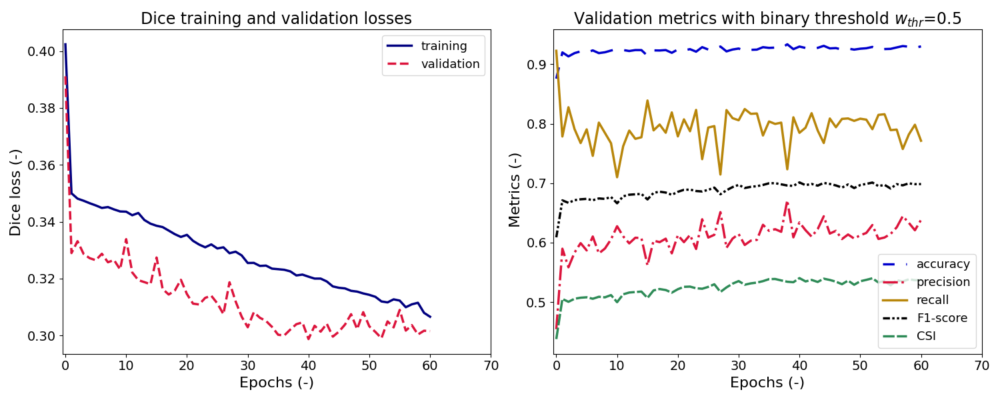

In [195]:
plot_losses_metrics(train_losses, val_losses, metrics, model_recall, loss_f=loss_f)

In [196]:
total_losses_metrics_dataset_min(model_loss, test_set, device=device)

6.0169945


([tensor(6.3151), tensor(5.7188)],
 [0.929094, 0.934848],
 [0.6526352110542157, 0.669014498122789],
 [0.8137144105041902, 0.8581951584206042],
 [0.7243274976575652, 0.7518876019965168],
 [0.5678005101838673, 0.6024197846277771])

In [199]:
total_losses_metrics_dataset_max(model_loss, test_set, loss_f='Dice', model_type='min loss', device=device)

Average metrics for test dataset using min loss model:

Dice loss:          2.714e-01
Accuracy:          0.930
Precision:         0.656
Recall:            0.824
F1 score:          0.729
CSI score:         0.574


In [198]:
total_losses_metrics_dataset_max(model_recall, test_set, model_type='max recall', device=device)

Average metrics for test dataset using max recall model:

BCE loss:          1.089e+01
Accuracy:          0.879
Precision:         0.486
Recall:            0.932
F1 score:          0.638
CSI score:         0.469


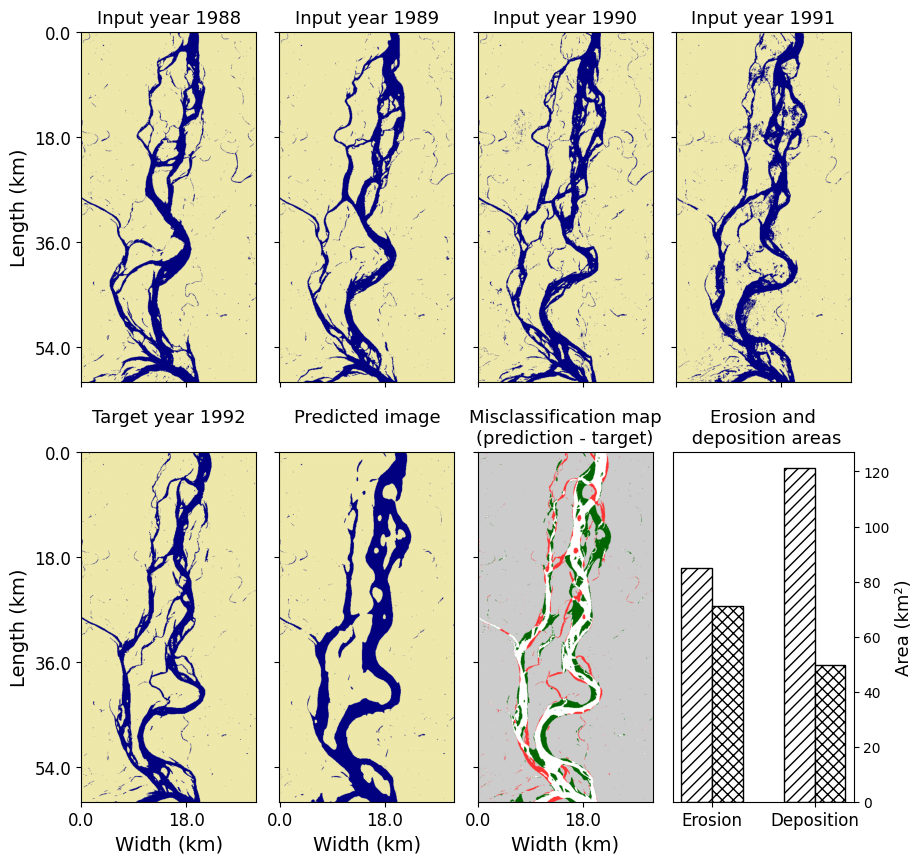

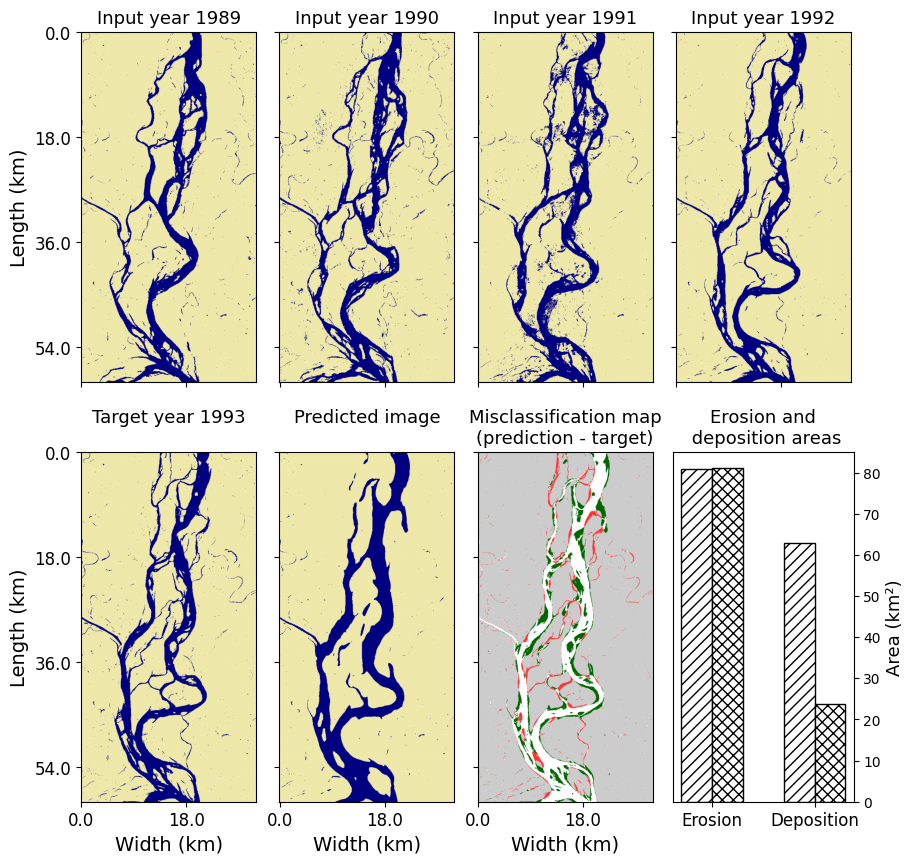

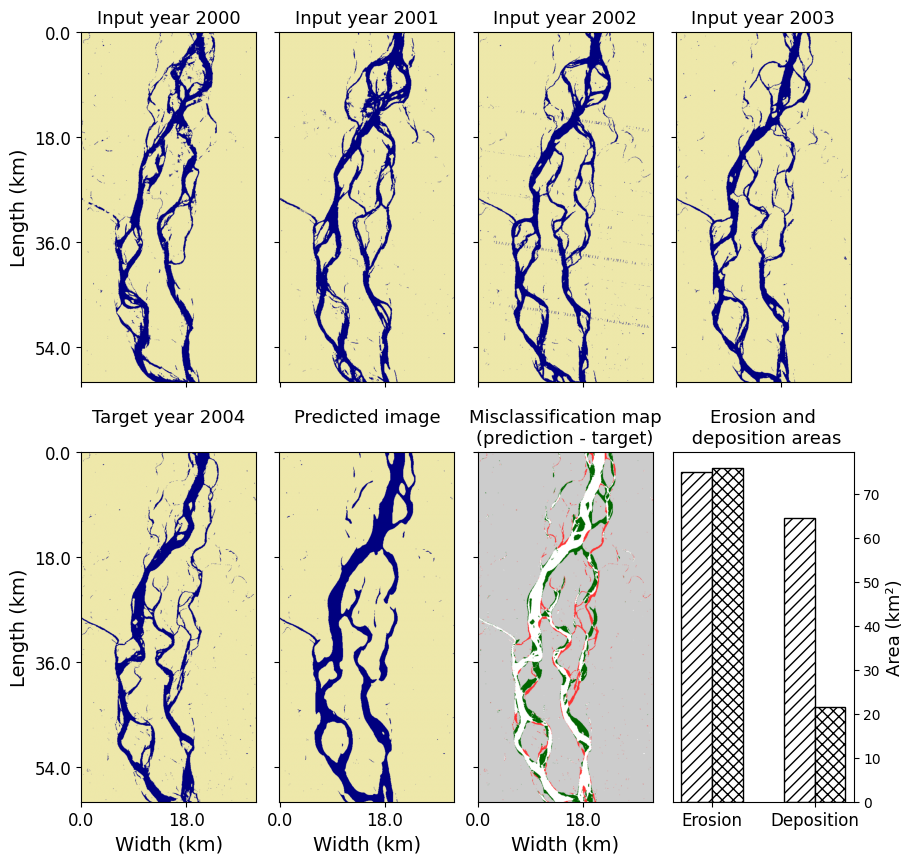

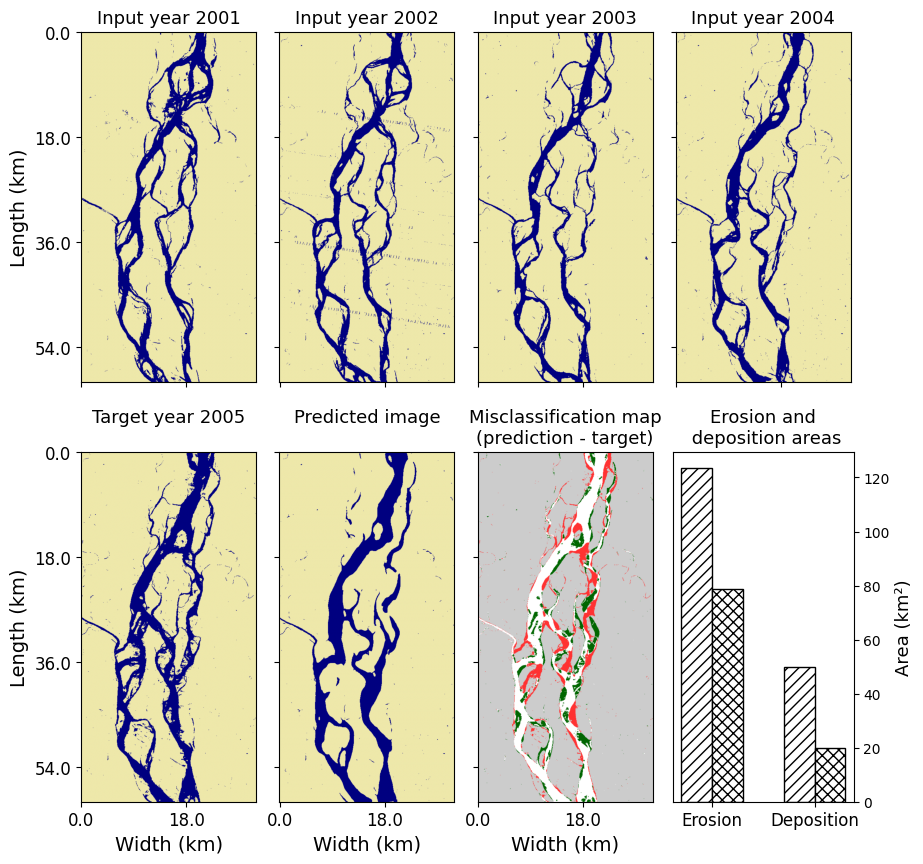

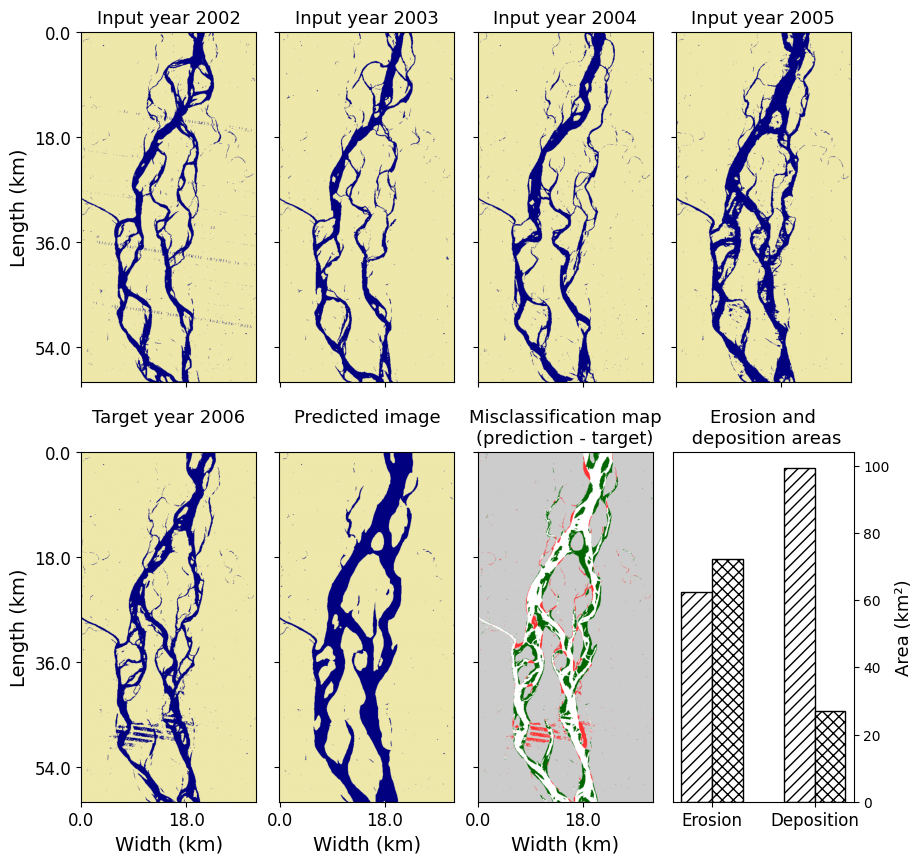

...

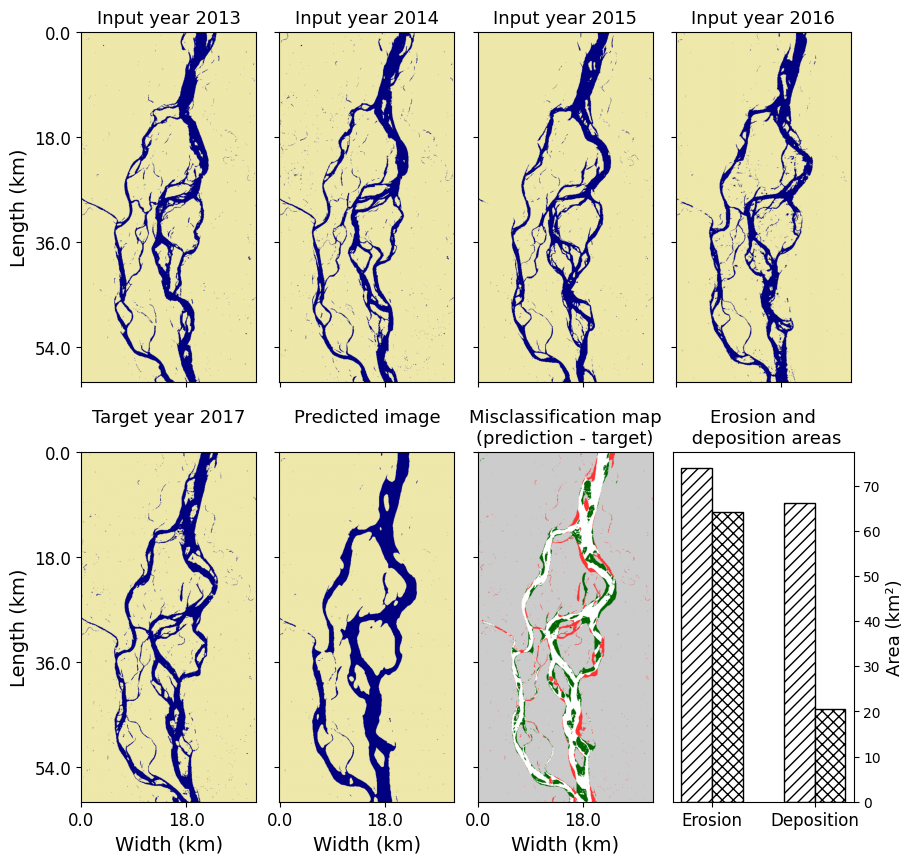

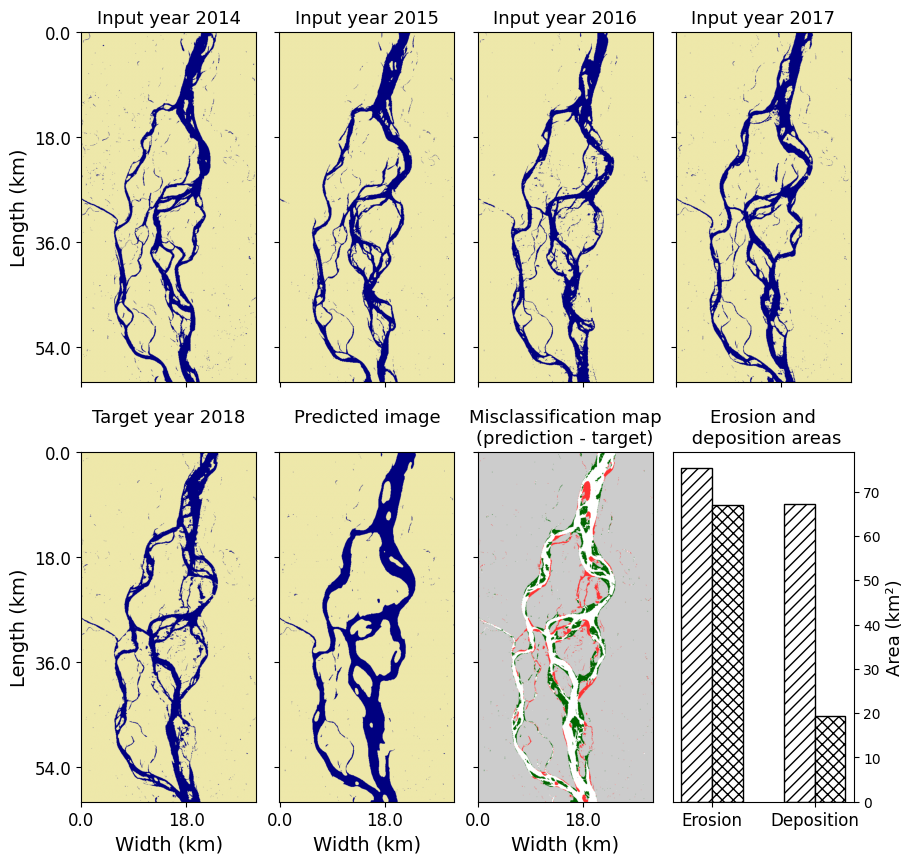

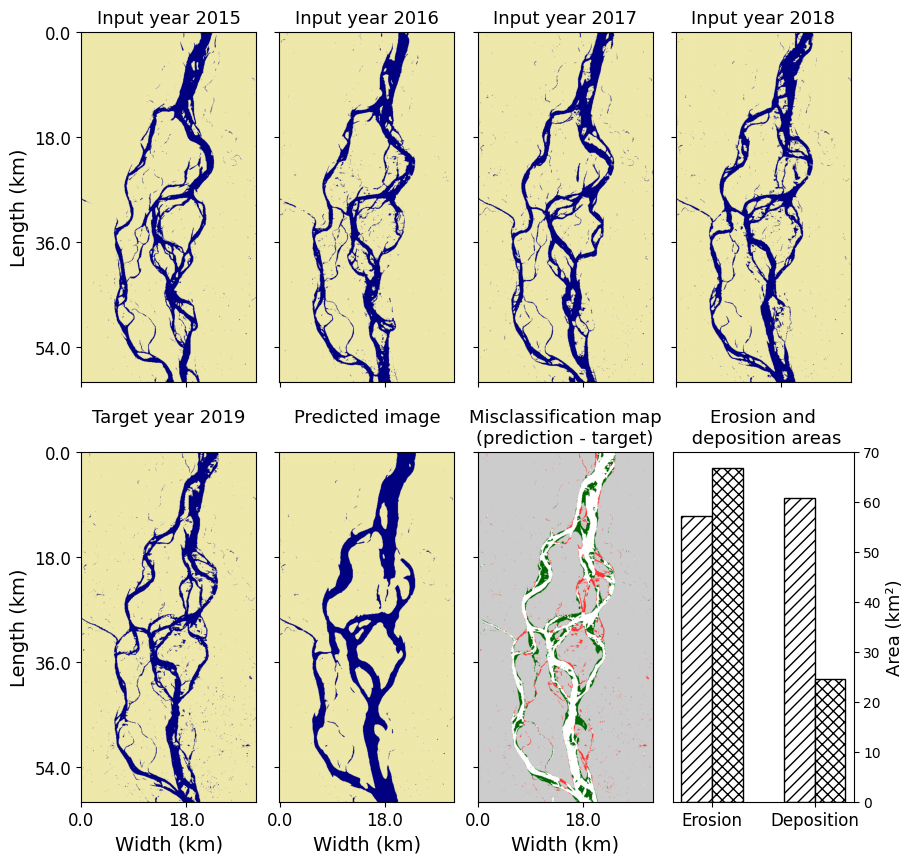

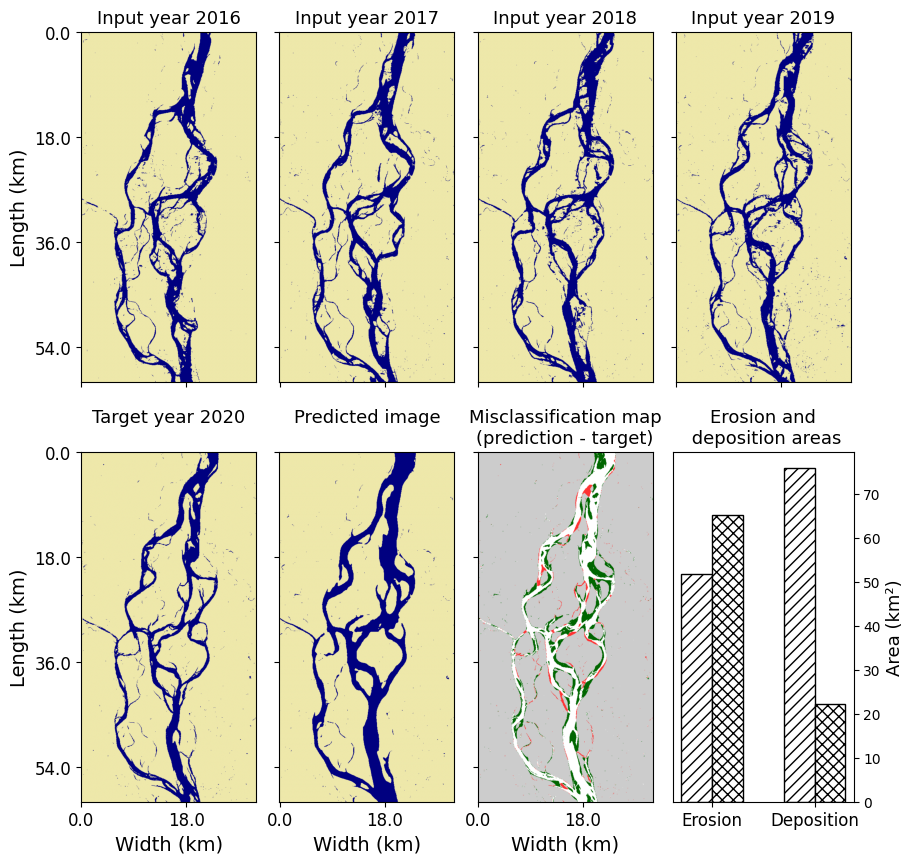

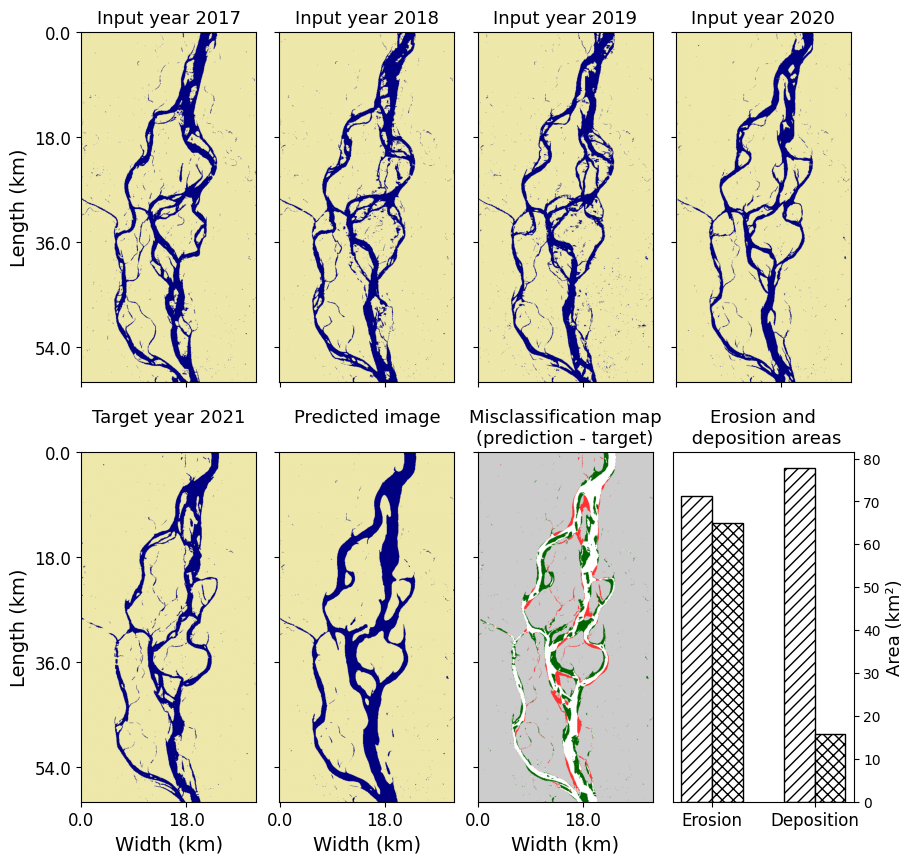

In [89]:
%matplotlib inline
for i in range(len(test_set)):
    show_evolution_nolegend(i, test_set, model_loss, device=device, save_img=False)

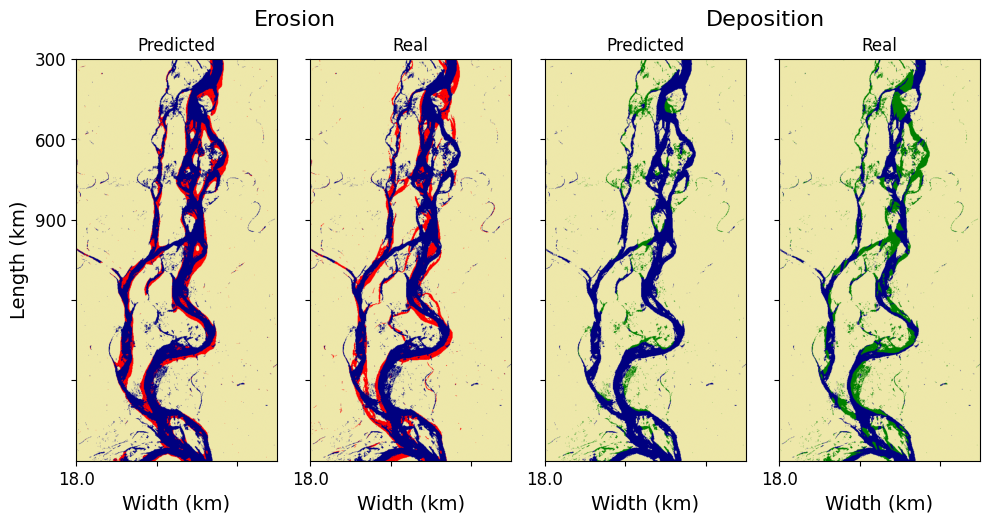

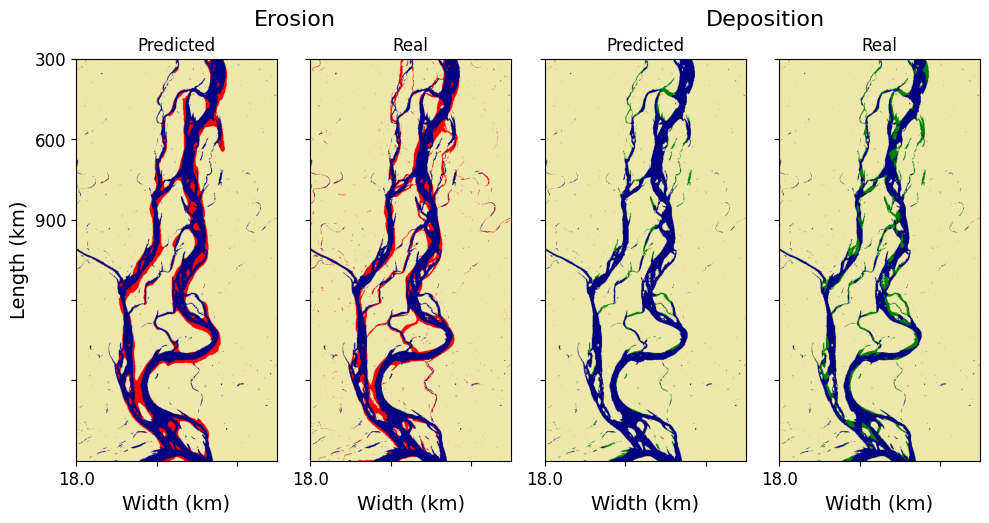

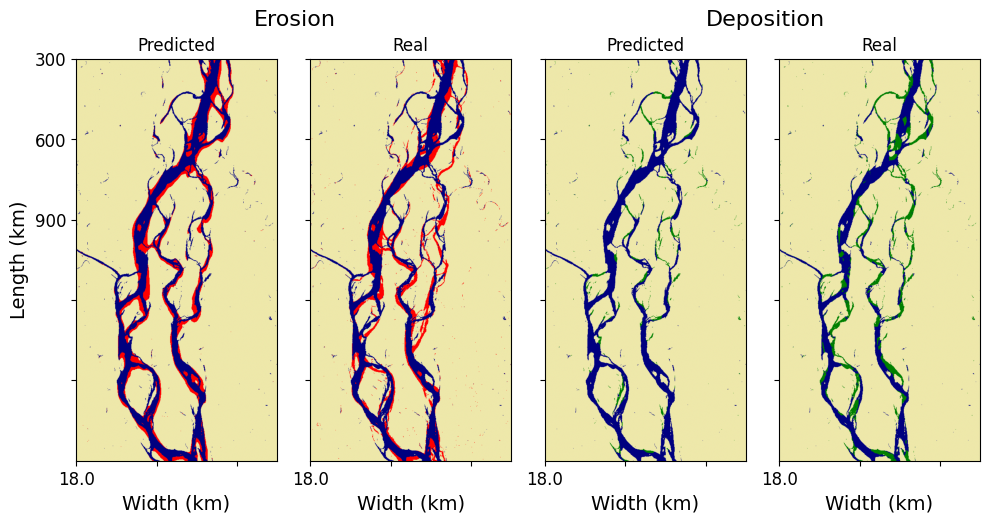

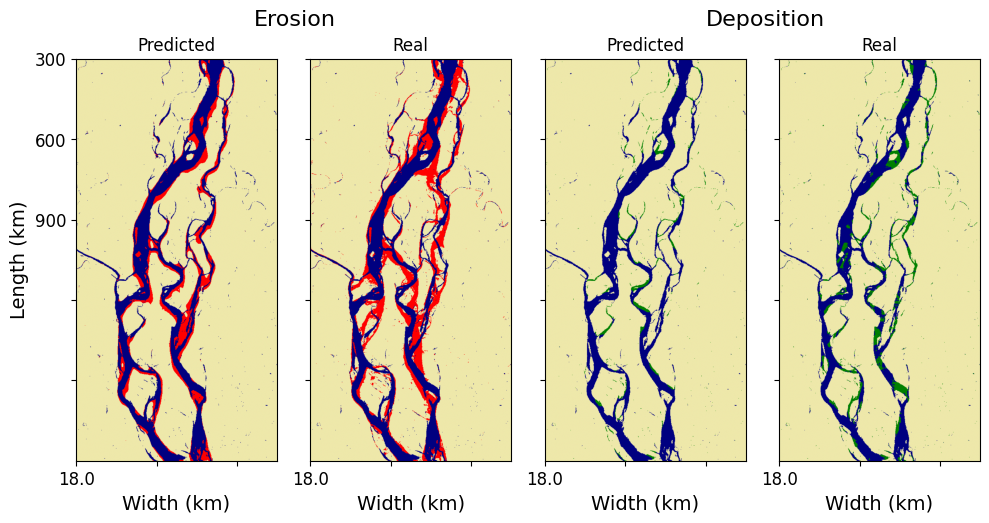

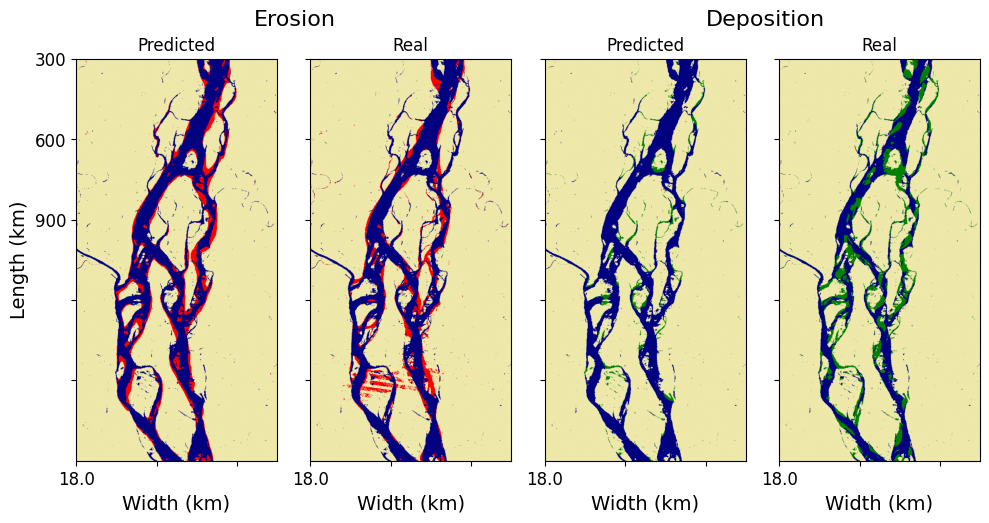

...

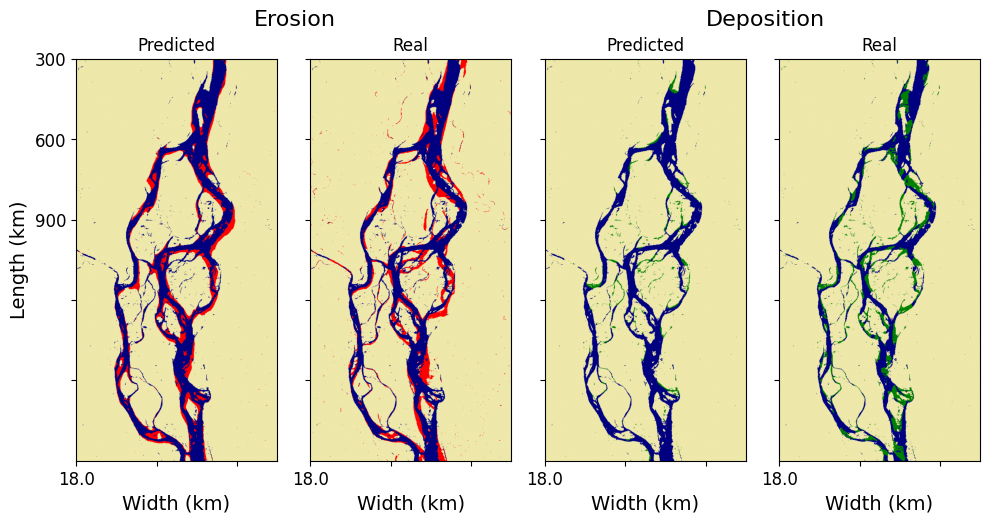

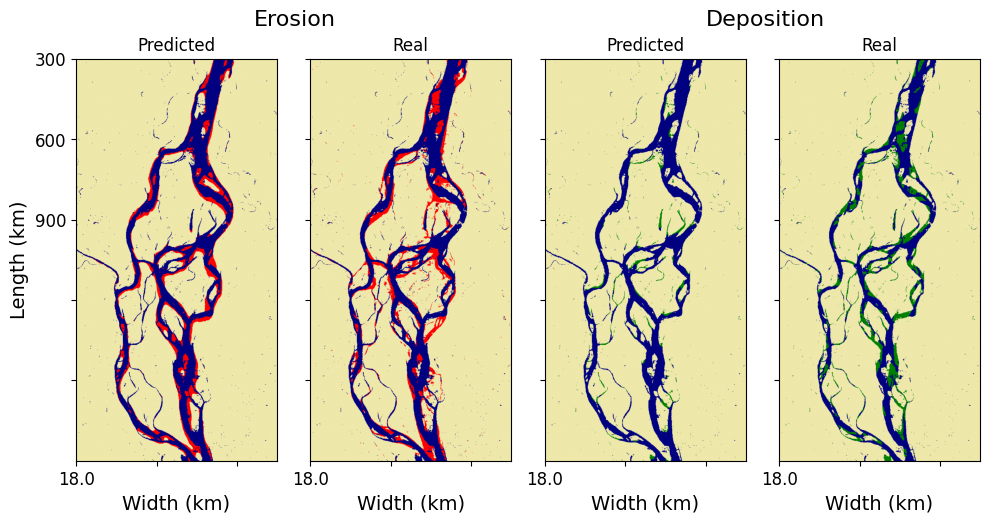

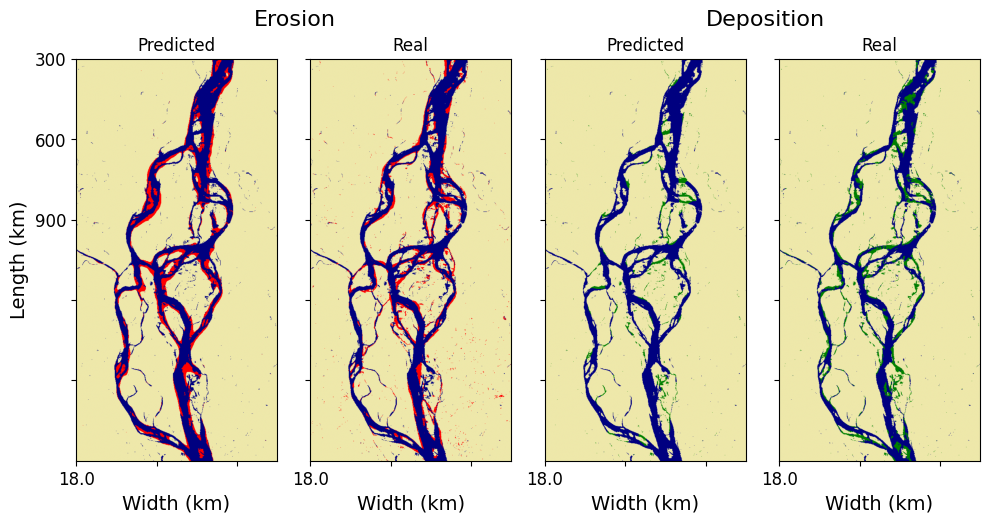

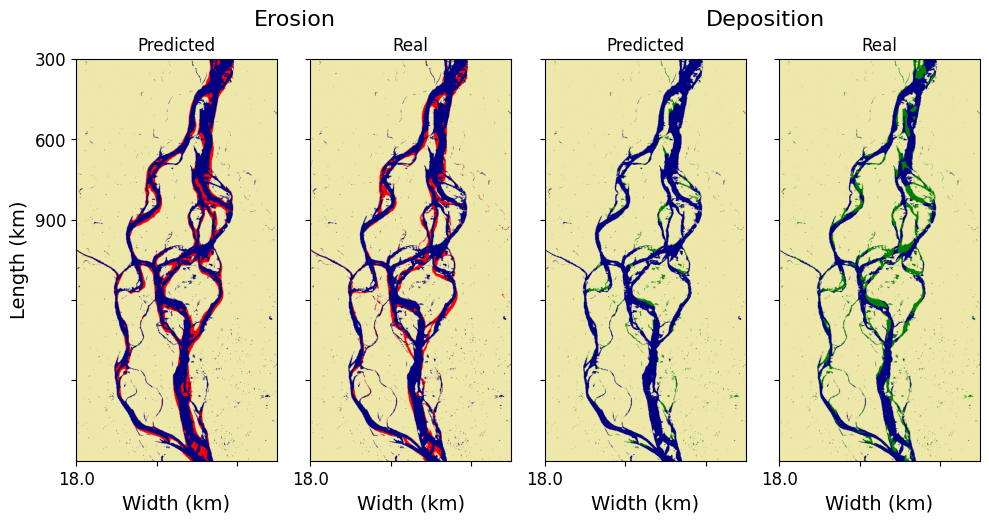

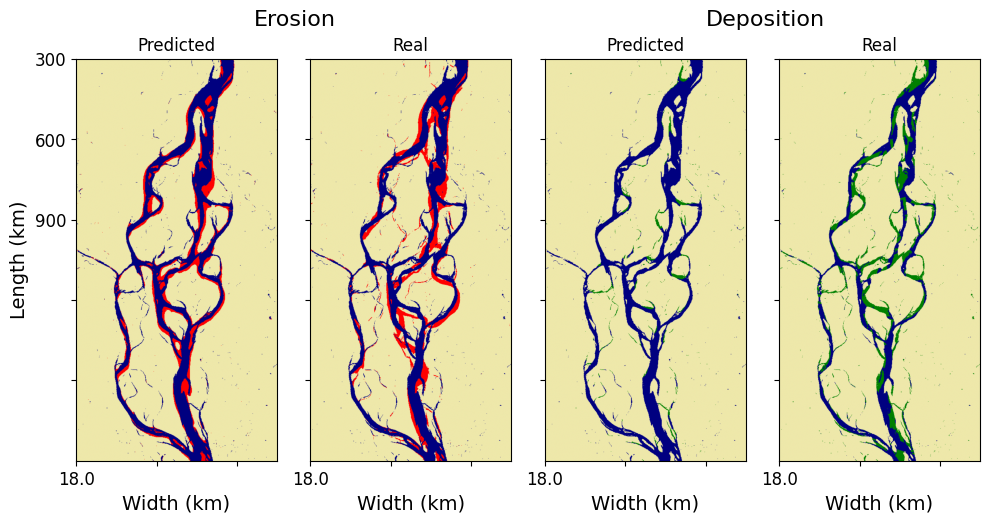

In [82]:
%matplotlib inline
for i in range(len(test_set)):
    erosion_sites(model_loss, test_set, i, device=device, save_img=False)

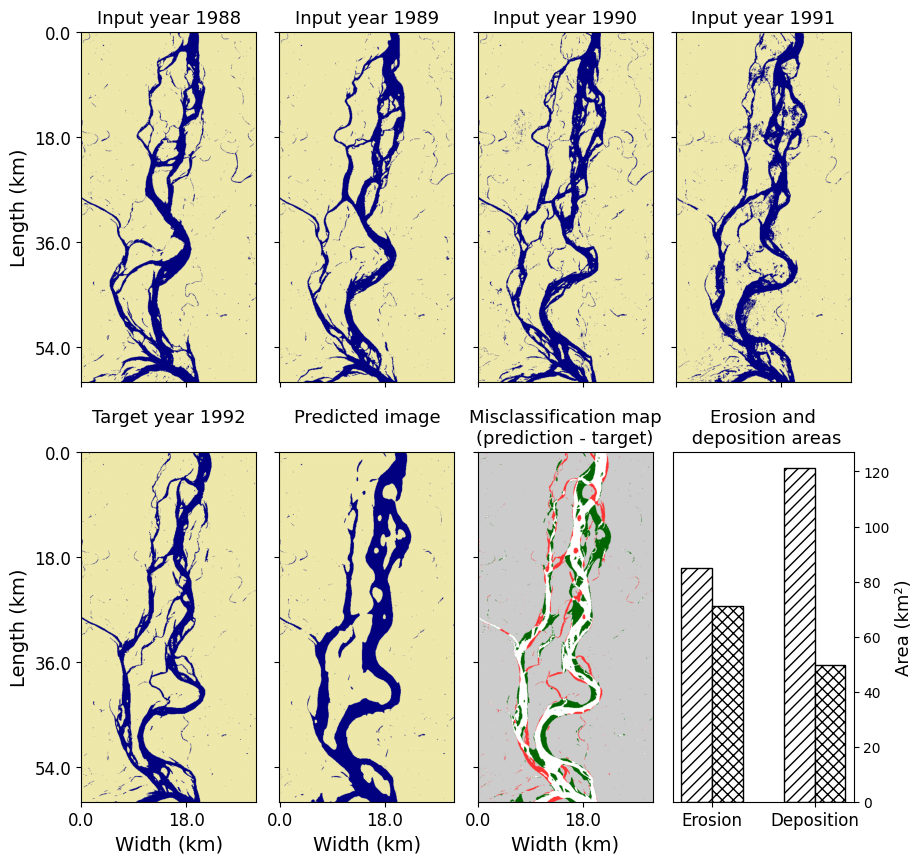

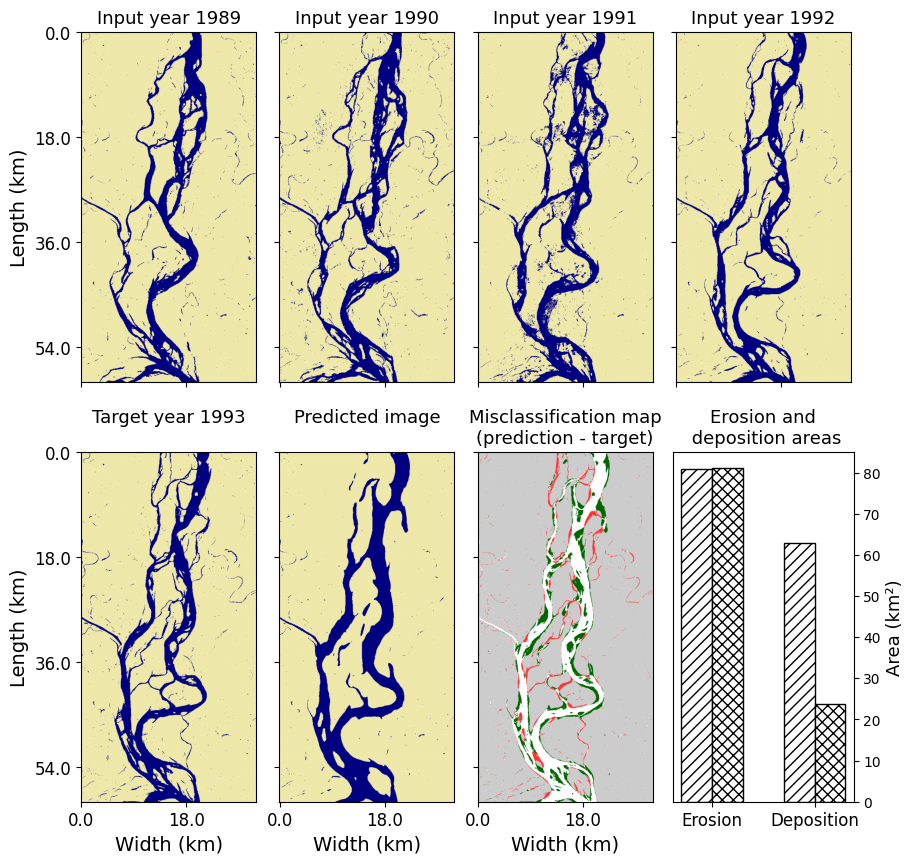

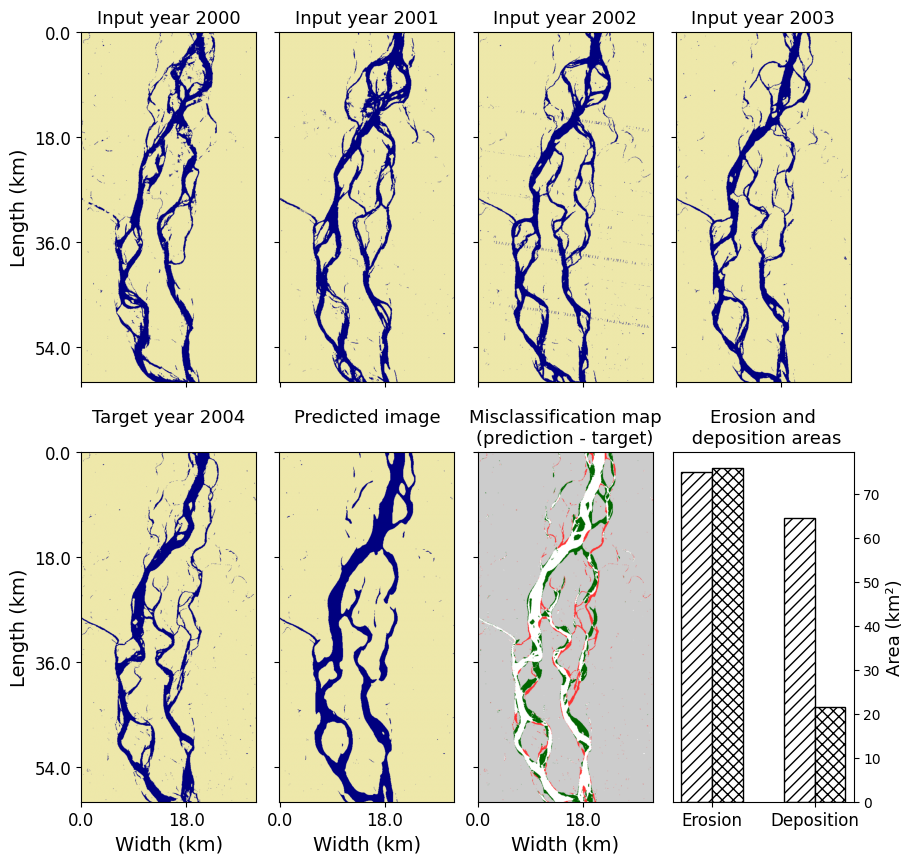

In [83]:
# visualise min loss model predictions with optimal threshold

%matplotlib inline
for i in range(3):
    show_evolution_nolegend(i, test_set, model_loss, water_threshold=new_thr, loss_recall='min loss_0.4', device=device, save_img=False)

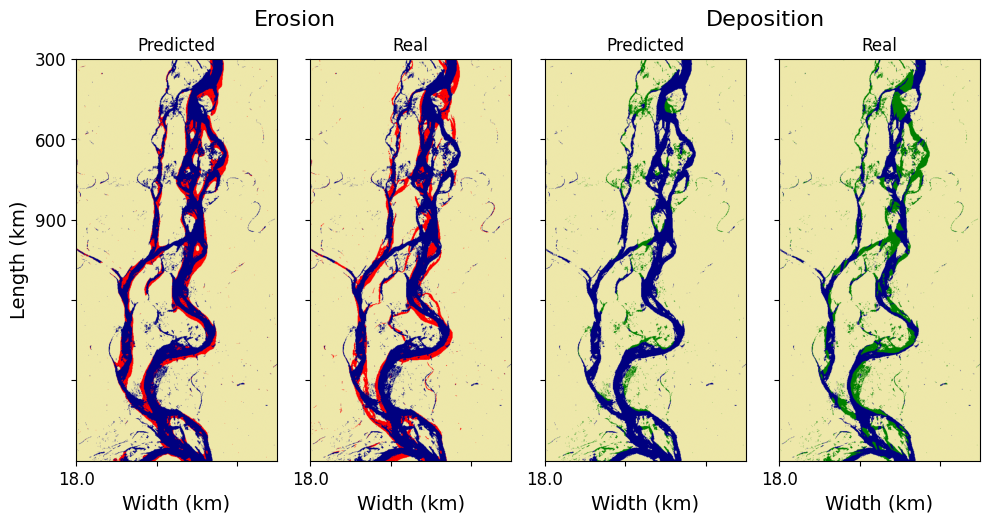

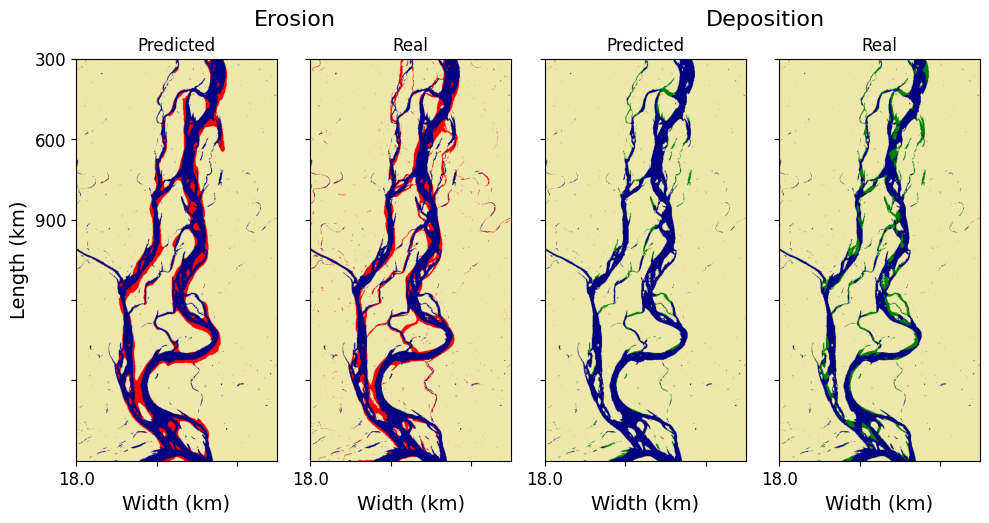

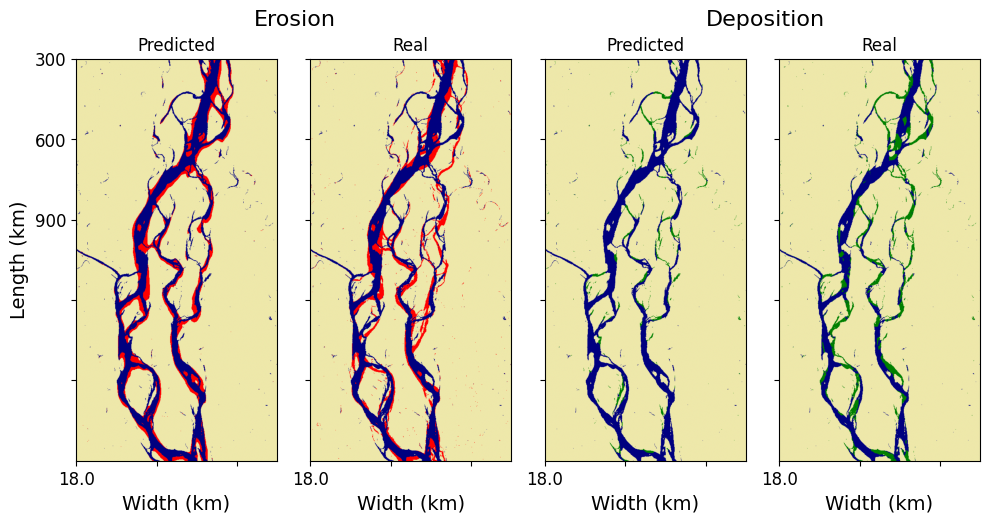

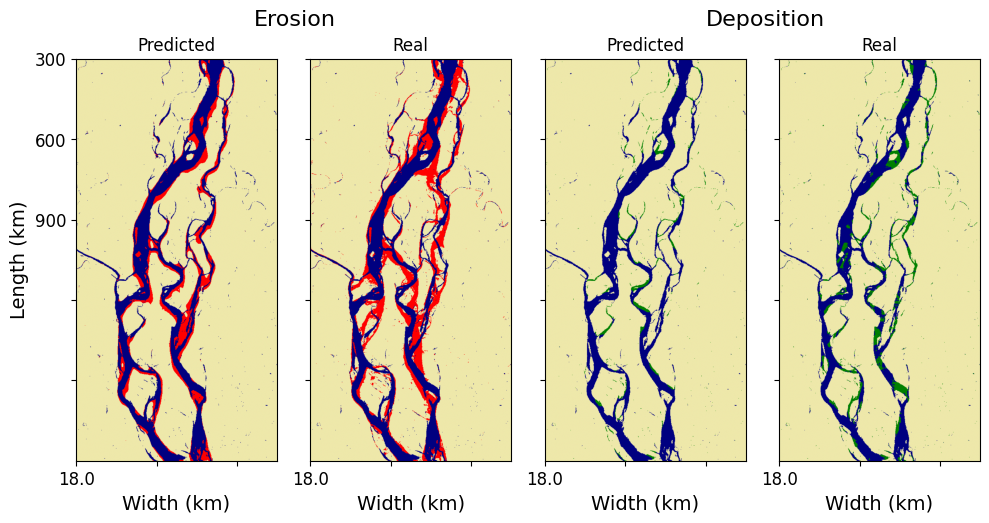

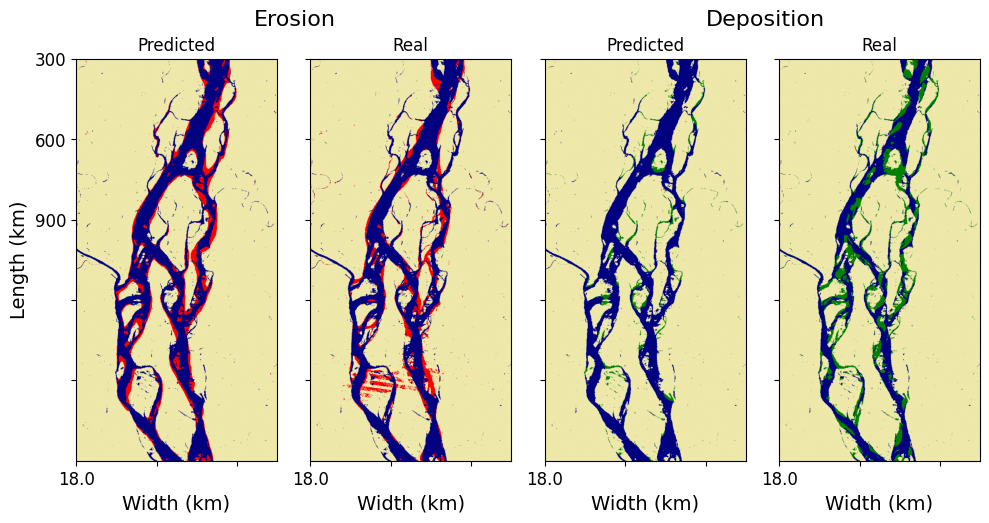

...

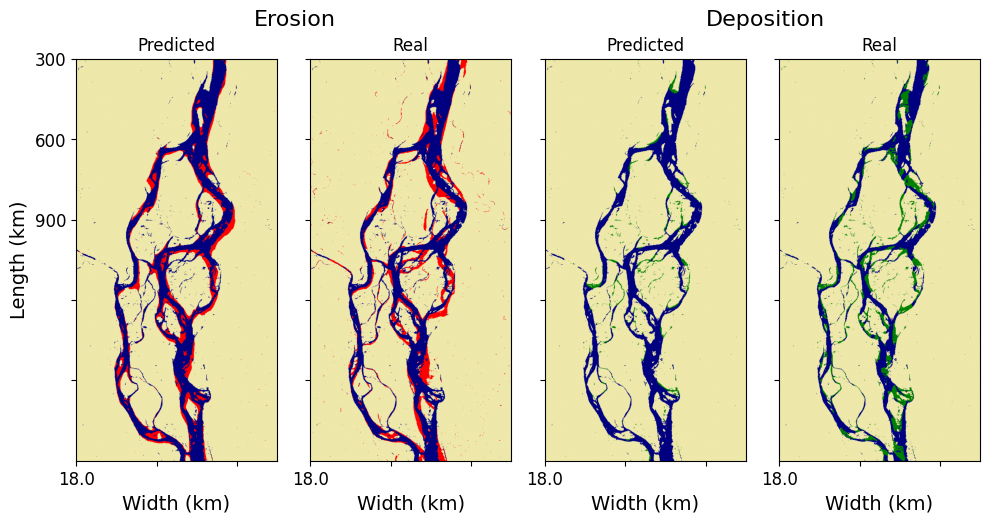

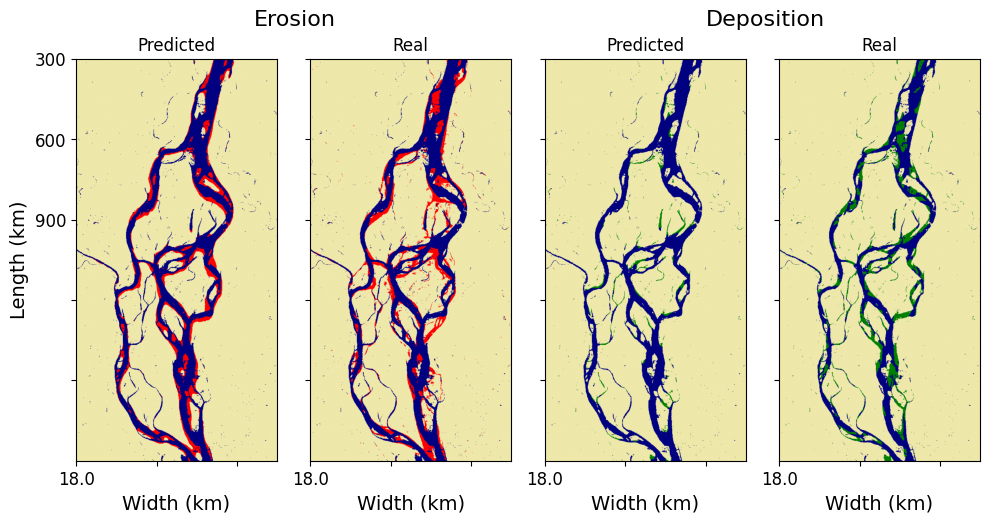

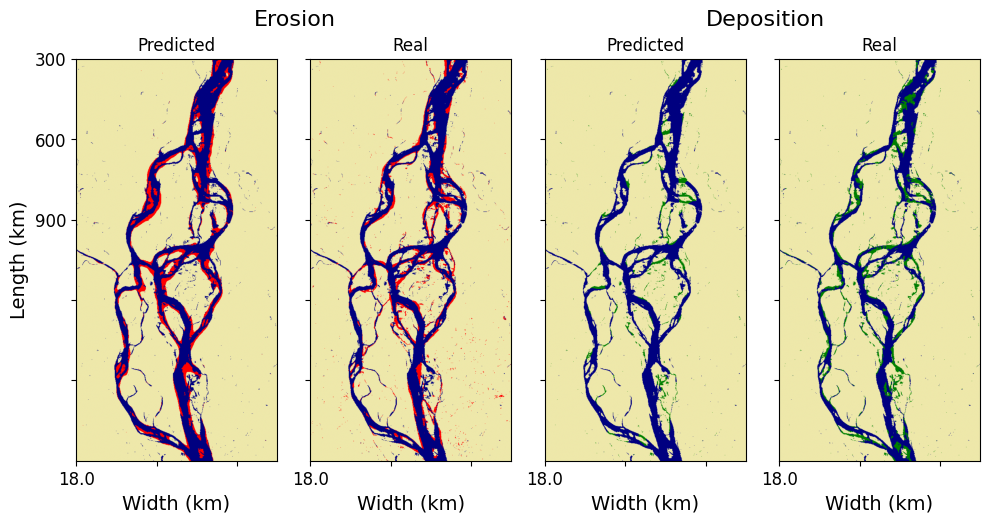

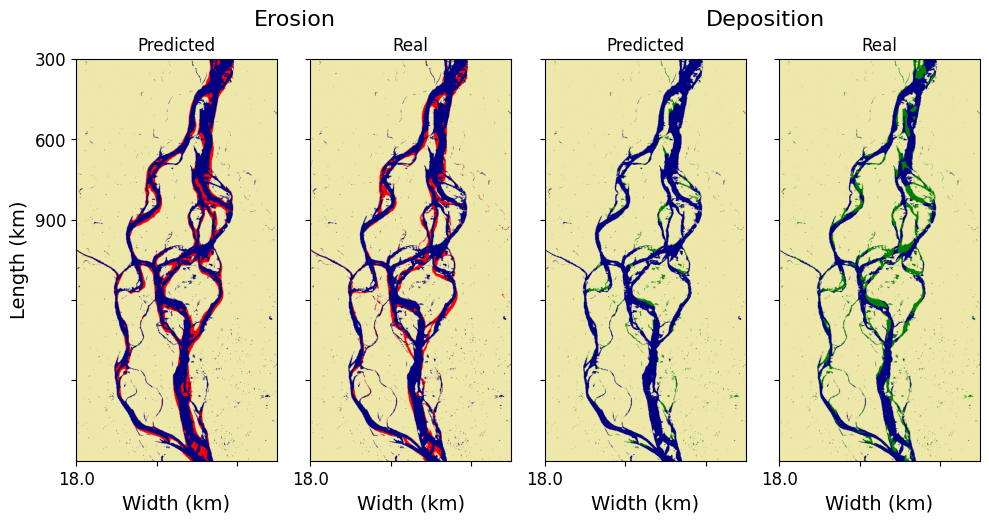

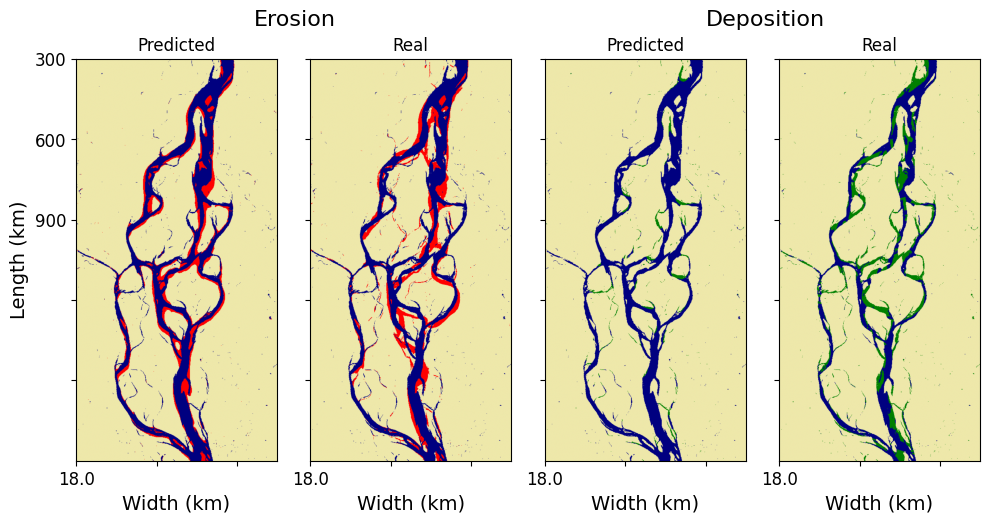

In [84]:
%matplotlib inline
for i in range(len(test_set)):
    erosion_sites(model_loss, test_set, i, water_threshold=new_thr, device=device, save_img=False)

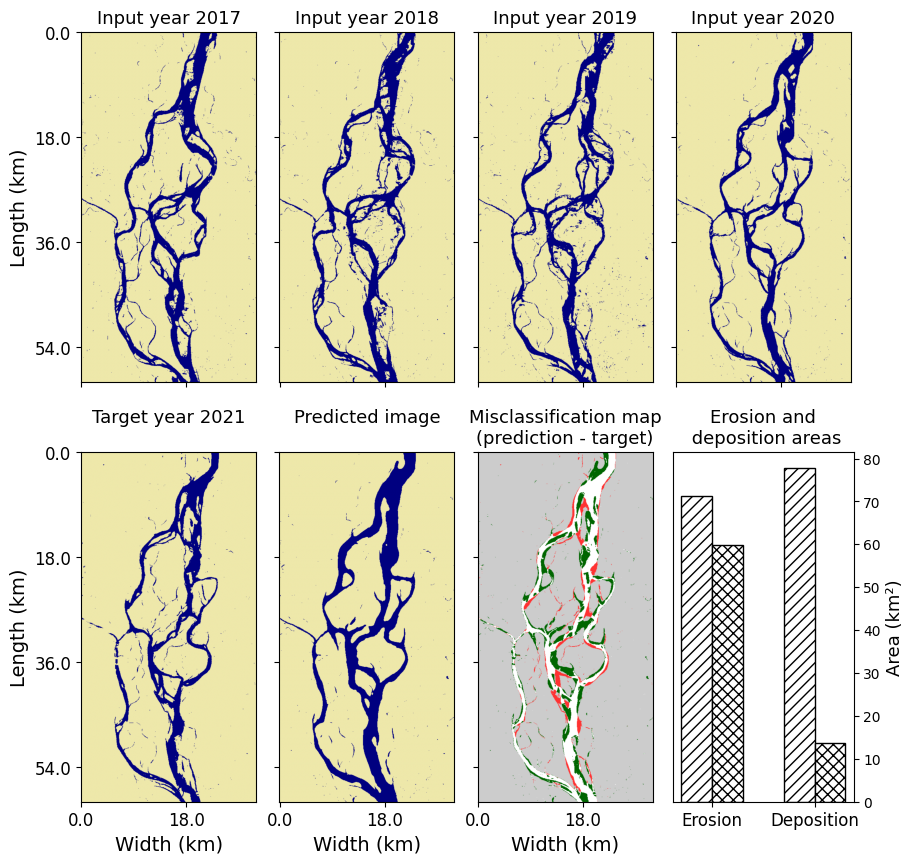

In [110]:
# direct comparison of same sample predictions with original threshold (0.5) and optimal threshold (0.402) 

%matplotlib inline
array = show_evolution_nolegend(19, test_set, model_loss, device=device, save_img=False)

In [114]:
np.save('prediction.npy', array)

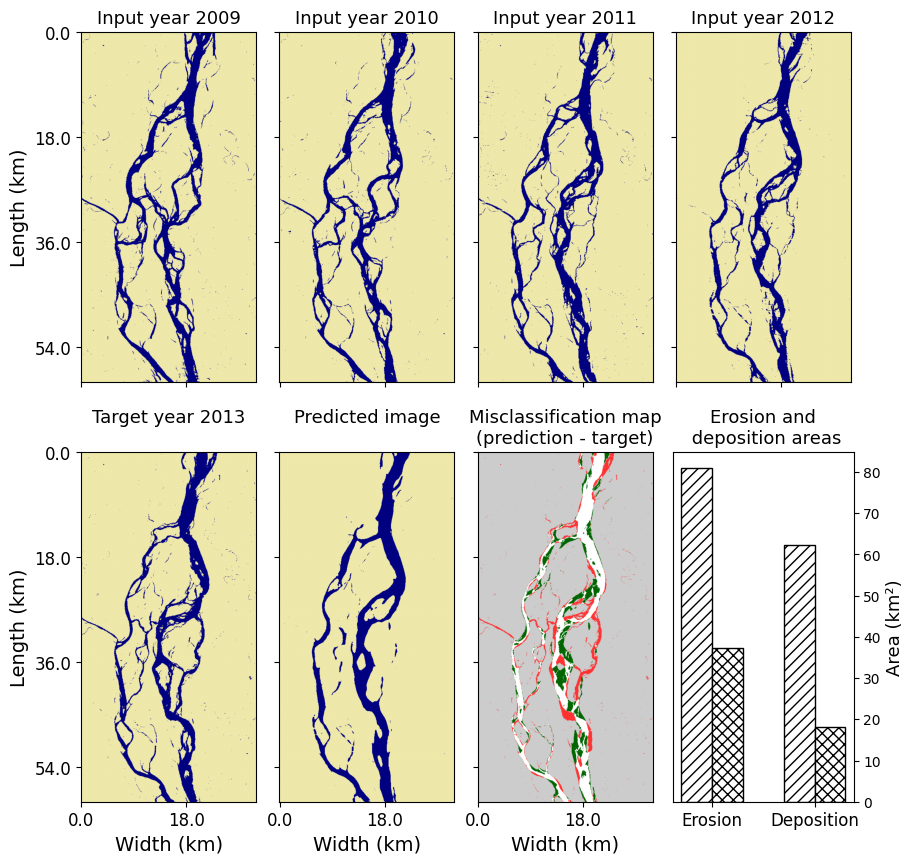

In [34]:
%matplotlib inline
show_evolution_nolegend(11, test_set, model_loss, water_threshold=new_thr, device=device, save_img=False)

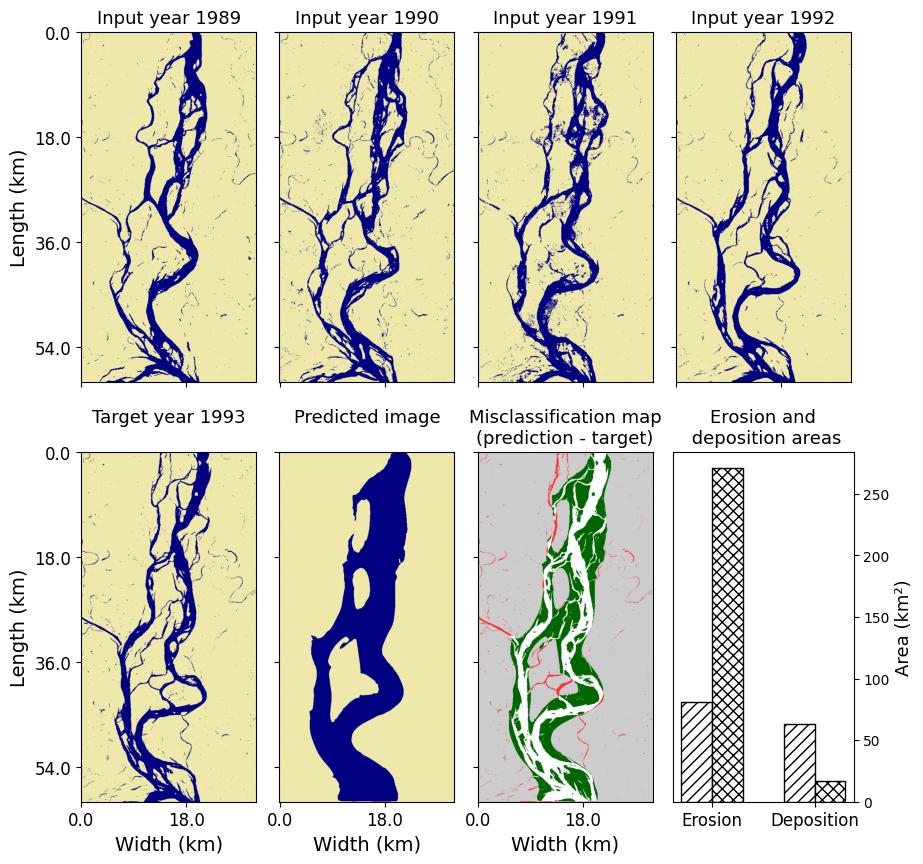

In [35]:
# max recall model predictions

%matplotlib inline
show_evolution_nolegend(1, test_set, model_recall, loss_recall='max recall', device=device, save_img=True)